# Analisis Time-Series Prediksi Energi Surya di ITS

Oleh Kelompok 16:
1. Muhammad Ivan Ardianadi Afiat / 5025221178
2. Irfan Ridhana / 5025221214

# Download Dataset

In [1]:
# Download Dataset
!pip install -q gdown

import gdown
import os

FILE_ID = '1AMNVX_4qhzOTve35WprMcakZbLw2gbmj'
OUTPUT_FILENAME = 'data.csv'

print(f"Starting download for file ID: {FILE_ID}")
gdown.download(id=FILE_ID, output=OUTPUT_FILENAME, quiet=False)

Starting download for file ID: 1AMNVX_4qhzOTve35WprMcakZbLw2gbmj


Downloading...
From (original): https://drive.google.com/uc?id=1AMNVX_4qhzOTve35WprMcakZbLw2gbmj
From (redirected): https://drive.google.com/uc?id=1AMNVX_4qhzOTve35WprMcakZbLw2gbmj&confirm=t&uuid=b5bc97bb-1ba4-47aa-9786-d5d7bfb38420
To: /content/data.csv
100%|██████████| 202M/202M [00:02<00:00, 75.3MB/s]


'data.csv'

# Import Library

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
%matplotlib inline

from google.colab import drive
drive.mount('/content/drive')

import warnings
warnings.filterwarnings('ignore')

In [3]:
df = pd.read_csv('/content/data.csv', low_memory=False)
df

,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),snowfall_archive_best_match (cm),snow_depth_archive_best_match (m),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),...,soil_temperature_28_to_100cm_era5_land (°C),soil_temperature_100_to_255cm_era5_land (°C),soil_moisture_0_to_7cm_era5_land (m³/m³),soil_moisture_7_to_28cm_era5_land (m³/m³),soil_moisture_28_to_100cm_era5_land (m³/m³),soil_moisture_100_to_255cm_era5_land (m³/m³),wet_bulb_temperature_2m_era5_land (°C),terrestrial_radiation_era5_land (W/m²),terrestrial_radiation_instant_era5_land (W/m²),is_day_era5_land ()
0,2000-01-01T00:00,25.0,93,23.7,30.7,0.0,0.0,0.0,0.0,0.23,...,28.1,29.0,0.322,0.331,0.306,0.250,24.1,0.0,0.0,0
1,2000-01-01T01:00,25.0,92,23.5,30.4,0.0,0.0,0.0,0.0,0.26,...,28.1,29.0,0.318,0.330,0.307,0.251,23.9,0.0,0.0,0
2,2000-01-01T02:00,24.5,93,23.3,29.5,0.0,0.0,0.0,0.0,0.22,...,28.1,29.0,0.315,0.329,0.307,0.251,23.6,0.0,0.0,0
3,2000-01-01T03:00,24.5,93,23.3,29.3,0.0,0.0,0.0,0.0,0.20,...,28.1,29.0,0.312,0.327,0.308,0.251,23.6,0.0,0.0,0
4,2000-01-01T04:00,24.4,94,23.4,29.2,0.0,0.0,0.0,0.0,0.18,...,28.1,29.0,0.309,0.326,0.308,0.251,23.7,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
227179,2025-11-30T19:00,28.7,80,25.0,34.9,0.0,0.0,0.0,0.0,0.77,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0
227180,2025-11-30T20:00,27.5,84,24.6,33.3,1.1,0.0,0.0,1.1,0.58,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0
227181,2025-11-30T21:00,27.4,83,24.3,33.0,0.0,0.0,0.0,0.0,0.60,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0
227182,2025-11-30T22:00,27.7,81,24.1,32.3,0.0,0.0,0.0,0.0,0.71,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0


# Data Visualization

## YData Profiling

In [ ]:
!pip -q install ydata_profiling
from ydata_profiling import ProfileReport

profile = ProfileReport(df,title="ITS Weather Data Report", minimal=True)
profile.to_file("report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 181/181 [00:18<00:00,  9.65it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile

## Heatmap & Correlation

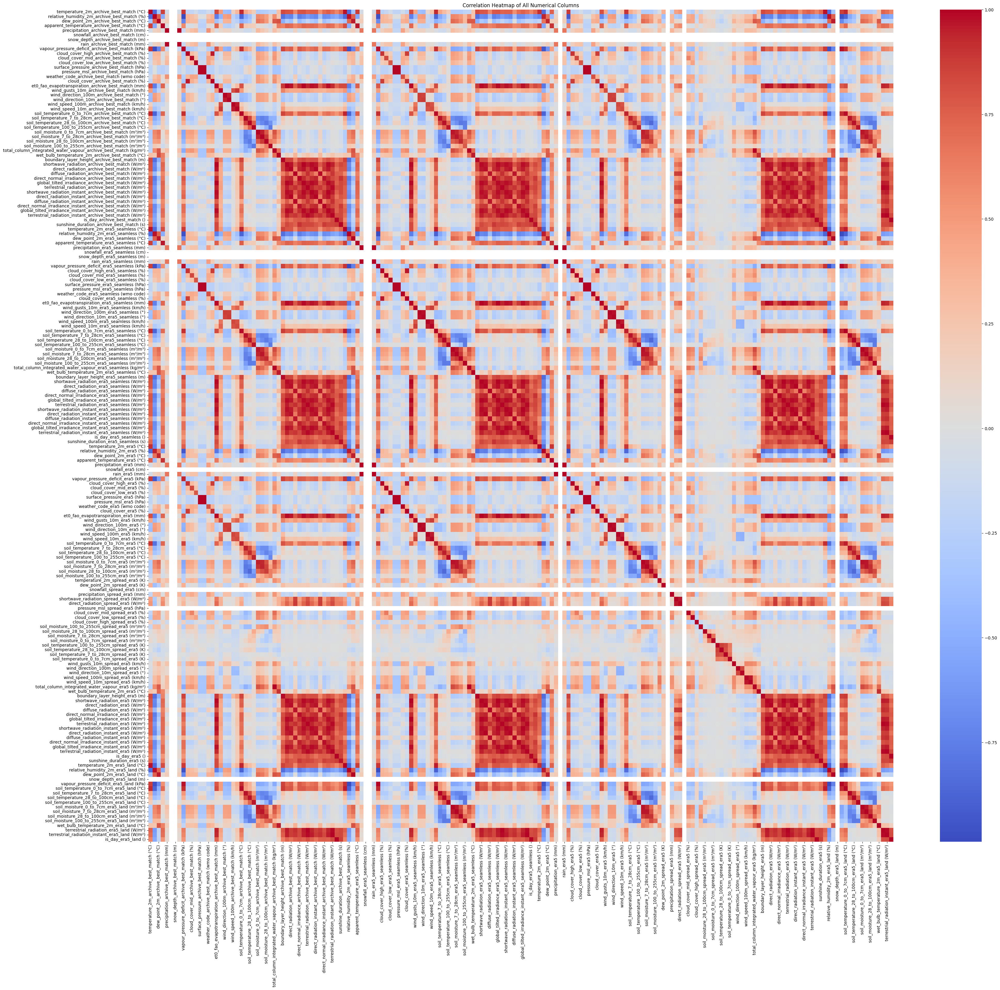

In [ ]:
plt.figure(figsize=(40, 36))
sns.heatmap(df.select_dtypes(include=np.number).corr(), cmap='coolwarm', annot=False)
plt.title('Correlation Heatmap of All Numerical Columns')
plt.show()

In [ ]:
corr_matrix = df.select_dtypes(include=np.number).corr()

corr_pairs = corr_matrix.unstack()

sorted_corr_pairs = corr_pairs.sort_values(ascending=False)

# Filter out self-correlations and duplicate pairs
filtered_corr = sorted_corr_pairs[sorted_corr_pairs != 1]
filtered_corr = filtered_corr[filtered_corr.index.map(lambda x: x[0] < x[1])]

print("Correlation of each column (highest positive to highest negative):\n")
for (col1, col2), corr_val in filtered_corr.items():
    print(f"{col1} | {col2} | {corr_val:.2f}")

Correlation of each column (highest positive to highest negative):

pressure_msl_archive_best_match (hPa) | surface_pressure_archive_best_match (hPa) | 1.00
pressure_msl_era5_seamless (hPa) | surface_pressure_era5 (hPa) | 1.00
pressure_msl_era5_seamless (hPa) | surface_pressure_era5_seamless (hPa) | 1.00
pressure_msl_era5 (hPa) | surface_pressure_era5_seamless (hPa) | 1.00
pressure_msl_era5 (hPa) | surface_pressure_era5 (hPa) | 1.00
global_tilted_irradiance_archive_best_match (W/m²) | shortwave_radiation_archive_best_match (W/m²) | 1.00
direct_radiation_instant_era5 (W/m²) | direct_radiation_instant_era5_seamless (W/m²) | 1.00
shortwave_radiation_instant_era5 (W/m²) | shortwave_radiation_instant_era5_seamless (W/m²) | 1.00
global_tilted_irradiance_instant_era5 (W/m²) | global_tilted_irradiance_instant_era5_seamless (W/m²) | 1.00
terrestrial_radiation_archive_best_match (W/m²) | terrestrial_radiation_era5_seamless (W/m²) | 1.00
terrestrial_radiation_archive_best_match (W/m²) | terrestri

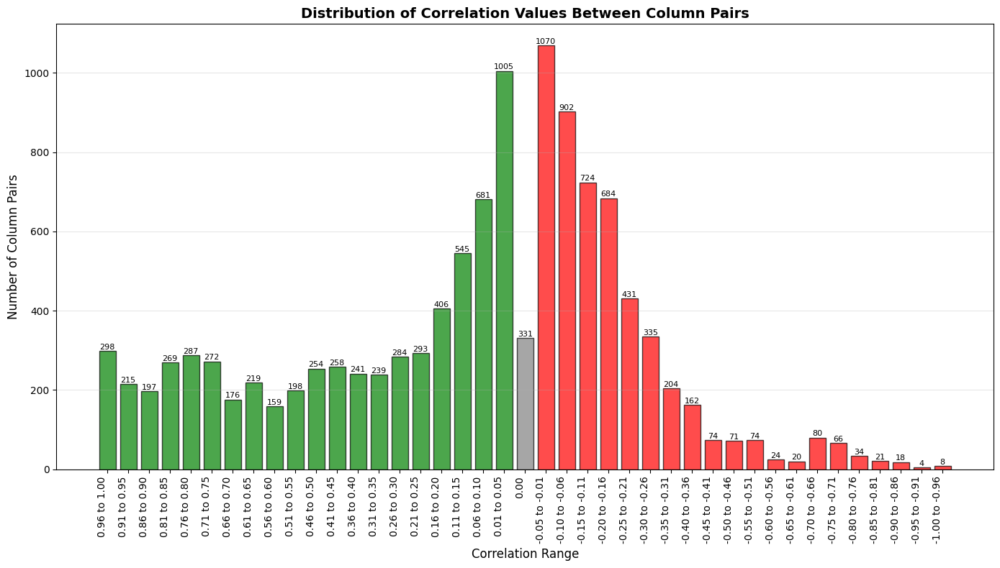

In [ ]:
corr_matrix = df.select_dtypes(include=np.number).corr()
corr_pairs = corr_matrix.unstack()
sorted_corr_pairs = corr_pairs.sort_values(ascending=False)

# Filter out self-correlations and duplicate pairs
filtered_corr = sorted_corr_pairs[sorted_corr_pairs != 1]
filtered_corr = filtered_corr[filtered_corr.index.map(lambda x: x[0] < x[1])]

# Define correlation bins
bins = [
    (0.96, 1.00), (0.91, 0.95), (0.86, 0.90), (0.81, 0.85), (0.76, 0.80),
    (0.71, 0.75), (0.66, 0.70), (0.61, 0.65), (0.56, 0.60), (0.51, 0.55),
    (0.46, 0.50), (0.41, 0.45), (0.36, 0.40), (0.31, 0.35), (0.26, 0.30),
    (0.21, 0.25), (0.16, 0.20), (0.11, 0.15), (0.06, 0.10), (0.01, 0.05),
    (0.00, 0.00),
    (-0.05, -0.01), (-0.10, -0.06), (-0.15, -0.11), (-0.20, -0.16),
    (-0.25, -0.21), (-0.30, -0.26), (-0.35, -0.31), (-0.40, -0.36),
    (-0.45, -0.41), (-0.50, -0.46), (-0.55, -0.51), (-0.60, -0.56),
    (-0.65, -0.61), (-0.70, -0.66), (-0.75, -0.71), (-0.80, -0.76),
    (-0.85, -0.81), (-0.90, -0.86), (-0.95, -0.91), (-1.00, -0.96)
]

# Count pairs in each bin
counts = []
labels = []

for low, high in bins:
    if low == 0.00 and high == 0.00:
        count = ((filtered_corr >= -0.005) & (filtered_corr <= 0.005)).sum()
        labels.append('0.00')
    else:
        count = ((filtered_corr >= low) & (filtered_corr <= high)).sum()
        labels.append(f'{low:.2f} to {high:.2f}')
    counts.append(count)

# Create bar chart
plt.figure(figsize=(14, 8))
colors = ['green' if b[0] > 0 else 'gray' if b[0] == 0 else 'red' for b in bins]
bars = plt.bar(range(len(counts)), counts, color=colors, alpha=0.7, edgecolor='black')

plt.xlabel('Correlation Range', fontsize=12)
plt.ylabel('Number of Column Pairs', fontsize=12)
plt.title('Distribution of Correlation Values Between Column Pairs', fontsize=14, fontweight='bold')
plt.xticks(range(len(labels)), labels, rotation=90, ha='right')
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()

# Add value labels on bars
for i, (bar, count) in enumerate(zip(bars, counts)):
    if count > 0:
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.5,
                 str(count), ha='center', va='bottom', fontsize=8)

plt.show()

In [ ]:
# sorted_column_names = sorted(df.columns)

# output_filename = 'column_names.txt'
# with open(output_filename, 'w') as f:
#     for col_name in sorted_column_names:
#         f.write(f'{col_name}\n')

# print(f"All column names, sorted alphabetically, have been saved to '{output_filename}'.")

All column names, sorted alphabetically, have been saved to 'column_names.txt'.


# Data Cleaning & Engineering

## Remove Duplication of Other Model Dataset

In [4]:
columns_to_remove = [
    col for col in df.columns if any(substring in col for substring in ['_era5', '_era5_land', '_era_seamless', '_spread_era5', '_instant'])
]
df_abm = df.drop(columns=columns_to_remove)

print(f"Original DataFrame shape: {df.shape}")
print(f"New DataFrame df_abm shape: {df_abm.shape}")
df_abm.head()

Original DataFrame shape: (227184, 181)
New DataFrame df_abm shape: (227184, 42)


,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),snowfall_archive_best_match (cm),snow_depth_archive_best_match (m),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),...,wet_bulb_temperature_2m_archive_best_match (°C),boundary_layer_height_archive_best_match (m),shortwave_radiation_archive_best_match (W/m²),direct_radiation_archive_best_match (W/m²),diffuse_radiation_archive_best_match (W/m²),direct_normal_irradiance_archive_best_match (W/m²),global_tilted_irradiance_archive_best_match (W/m²),terrestrial_radiation_archive_best_match (W/m²),is_day_archive_best_match (),sunshine_duration_archive_best_match (s)
0,2000-01-01T00:00,25.0,93,23.7,30.7,0.0,0.0,0.0,0.0,0.23,...,24.1,130.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
1,2000-01-01T01:00,25.0,92,23.5,30.4,0.0,0.0,0.0,0.0,0.26,...,23.9,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
2,2000-01-01T02:00,24.5,93,23.3,29.5,0.0,0.0,0.0,0.0,0.22,...,23.6,175.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
3,2000-01-01T03:00,24.5,93,23.3,29.3,0.0,0.0,0.0,0.0,0.20,...,23.6,185.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
4,2000-01-01T04:00,24.4,94,23.4,29.2,0.0,0.0,0.0,0.0,0.18,...,23.7,190.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0


## Remove Constant Column

In [5]:
columns_to_drop_constant = [col for col in df_abm.columns if df_abm[col].nunique() == 1]

if columns_to_drop_constant:
    df_abm = df_abm.drop(columns=columns_to_drop_constant)
    print(f"Removed {len(columns_to_drop_constant)} constant columns: {columns_to_drop_constant}")
    print(f"New df_abm_cleaned shape: {df_abm.shape}")
else:
    df_abm = df_abm.copy()
    print("No constant columns found to remove.")

df_abm.head()

Removed 2 constant columns: ['snowfall_archive_best_match (cm)', 'snow_depth_archive_best_match (m)']
New df_abm_cleaned shape: (227184, 40)


,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),cloud_cover_high_archive_best_match (%),cloud_cover_mid_archive_best_match (%),...,wet_bulb_temperature_2m_archive_best_match (°C),boundary_layer_height_archive_best_match (m),shortwave_radiation_archive_best_match (W/m²),direct_radiation_archive_best_match (W/m²),diffuse_radiation_archive_best_match (W/m²),direct_normal_irradiance_archive_best_match (W/m²),global_tilted_irradiance_archive_best_match (W/m²),terrestrial_radiation_archive_best_match (W/m²),is_day_archive_best_match (),sunshine_duration_archive_best_match (s)
0,2000-01-01T00:00,25.0,93,23.7,30.7,0.0,0.0,0.23,93,6,...,24.1,130.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
1,2000-01-01T01:00,25.0,92,23.5,30.4,0.0,0.0,0.26,97,0,...,23.9,140.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
2,2000-01-01T02:00,24.5,93,23.3,29.5,0.0,0.0,0.22,99,2,...,23.6,175.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
3,2000-01-01T03:00,24.5,93,23.3,29.3,0.0,0.0,0.20,98,4,...,23.6,185.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0
4,2000-01-01T04:00,24.4,94,23.4,29.2,0.0,0.0,0.18,99,1,...,23.7,190.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0


## Remove Night Data

In [6]:
df_abm = df_abm[df_abm['is_day_archive_best_match ()'] != 0]
print(f"Shape after removing rows where is_day_archive_best_match == 0: {df_abm.shape}")

Shape after removing rows where is_day_archive_best_match == 0: (113592, 40)


## Remove Non Relevant Column

In [7]:
columns_to_drop_specific = [
    'weather_code_archive_best_match (wmo code)',
    'sunshine_duration_archive_best_match (s)',
    'is_day_archive_best_match ()',
    'global_tilted_irradiance_archive_best_match (W/m²)',
    'pressure_msl_archive_best_match (hPa)'
]
df_abm = df_abm.drop(columns=columns_to_drop_specific)
print(f"Shape after dropping specific columns: {df_abm.shape}")

df_abm.head()

Shape after dropping specific columns: (113592, 35)


,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),cloud_cover_high_archive_best_match (%),cloud_cover_mid_archive_best_match (%),...,soil_moisture_28_to_100cm_archive_best_match (m³/m³),soil_moisture_100_to_255cm_archive_best_match (m³/m³),total_column_integrated_water_vapour_archive_best_match (kg/m²),wet_bulb_temperature_2m_archive_best_match (°C),boundary_layer_height_archive_best_match (m),shortwave_radiation_archive_best_match (W/m²),direct_radiation_archive_best_match (W/m²),diffuse_radiation_archive_best_match (W/m²),direct_normal_irradiance_archive_best_match (W/m²),terrestrial_radiation_archive_best_match (W/m²)
6,2000-01-01T06:00,24.5,94,23.6,29.3,0.0,0.0,0.17,100,0,...,0.308,0.251,53.9,23.8,210.0,17.0,3.0,14.0,25.6,104.1
7,2000-01-01T07:00,25.2,91,23.6,30.4,0.0,0.0,0.29,99,13,...,0.309,0.251,55.8,24.0,235.0,136.0,38.0,98.0,136.7,393.3
8,2000-01-01T08:00,26.2,86,23.6,31.3,0.0,0.0,0.48,98,18,...,0.309,0.251,56.0,24.3,350.0,302.0,119.0,183.0,238.9,704.7
9,2000-01-01T09:00,27.3,80,23.5,32.1,0.0,0.0,0.73,100,12,...,0.309,0.252,56.0,24.5,505.0,470.0,238.0,232.0,346.0,972.9
10,2000-01-01T10:00,28.3,75,23.4,33.2,0.0,0.0,0.98,97,18,...,0.309,0.252,55.9,24.7,655.0,607.0,336.0,271.0,402.9,1179.6


## Convert Column Time to Datetime

In [8]:
df_abm['time'] = pd.to_datetime(df_abm['time'])
print("Converted 'time' column to datetime objects.")
df_abm.head()

Converted 'time' column to datetime objects.


,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),cloud_cover_high_archive_best_match (%),cloud_cover_mid_archive_best_match (%),...,soil_moisture_28_to_100cm_archive_best_match (m³/m³),soil_moisture_100_to_255cm_archive_best_match (m³/m³),total_column_integrated_water_vapour_archive_best_match (kg/m²),wet_bulb_temperature_2m_archive_best_match (°C),boundary_layer_height_archive_best_match (m),shortwave_radiation_archive_best_match (W/m²),direct_radiation_archive_best_match (W/m²),diffuse_radiation_archive_best_match (W/m²),direct_normal_irradiance_archive_best_match (W/m²),terrestrial_radiation_archive_best_match (W/m²)
6,2000-01-01 06:00:00,24.5,94,23.6,29.3,0.0,0.0,0.17,100,0,...,0.308,0.251,53.9,23.8,210.0,17.0,3.0,14.0,25.6,104.1
7,2000-01-01 07:00:00,25.2,91,23.6,30.4,0.0,0.0,0.29,99,13,...,0.309,0.251,55.8,24.0,235.0,136.0,38.0,98.0,136.7,393.3
8,2000-01-01 08:00:00,26.2,86,23.6,31.3,0.0,0.0,0.48,98,18,...,0.309,0.251,56.0,24.3,350.0,302.0,119.0,183.0,238.9,704.7
9,2000-01-01 09:00:00,27.3,80,23.5,32.1,0.0,0.0,0.73,100,12,...,0.309,0.252,56.0,24.5,505.0,470.0,238.0,232.0,346.0,972.9
10,2000-01-01 10:00:00,28.3,75,23.4,33.2,0.0,0.0,0.98,97,18,...,0.309,0.252,55.9,24.7,655.0,607.0,336.0,271.0,402.9,1179.6


## Solar Panel Efficiency

In [9]:
df_abm_f = df_abm.copy()

# Create new column 'solar_panel_energy' with 20% efficiency
df_abm_f['solar_panel_energy'] = df_abm_f['shortwave_radiation_archive_best_match (W/m²)'] * 0.20

## Remove Other Similar Solar Data

In [10]:
# Identify columns to remove that contain '(W/m²)'
columns_to_remove_wm2 = [col for col in df_abm_f.columns if re.search(r'\(W/m\u00b2\)', col)]

# Remove identified columns
df_abm_f = df_abm_f.drop(columns=columns_to_remove_wm2)

print("New DataFrame df_abm_f created with 'solar_panel_energy' and (W/m²) columns removed.")
print(f"New DataFrame shape: {df_abm_f.shape}")
print(df_abm_f.head())

New DataFrame df_abm_f created with 'solar_panel_energy' and (W/m²) columns removed.
New DataFrame shape: (113592, 31)
                  time  temperature_2m_archive_best_match (°C)  \
6  2000-01-01 06:00:00                                    24.5   
7  2000-01-01 07:00:00                                    25.2   
8  2000-01-01 08:00:00                                    26.2   
9  2000-01-01 09:00:00                                    27.3   
10 2000-01-01 10:00:00                                    28.3   

    relative_humidity_2m_archive_best_match (%)  \
6                                            94   
7                                            91   
8                                            86   
9                                            80   
10                                           75   

    dew_point_2m_archive_best_match (°C)  \
6                                   23.6   
7                                   23.6   
8                                   23.6   
9

## Remove Additional Column

In [11]:
columns_to_drop_specific = [
    'et0_fao_evapotranspiration_archive_best_match (mm)',
    'boundary_layer_height_archive_best_match (m)'
]
df_abm_f = df_abm_f.drop(columns=columns_to_drop_specific)
print(f"Shape after dropping specific columns: {df_abm_f.shape}")

df_abm_f.head()

Shape after dropping specific columns: (113592, 29)


,time,temperature_2m_archive_best_match (°C),relative_humidity_2m_archive_best_match (%),dew_point_2m_archive_best_match (°C),apparent_temperature_archive_best_match (°C),precipitation_archive_best_match (mm),rain_archive_best_match (mm),vapour_pressure_deficit_archive_best_match (kPa),cloud_cover_high_archive_best_match (%),cloud_cover_mid_archive_best_match (%),...,soil_temperature_7_to_28cm_archive_best_match (°C),soil_temperature_28_to_100cm_archive_best_match (°C),soil_temperature_100_to_255cm_archive_best_match (°C),soil_moisture_0_to_7cm_archive_best_match (m³/m³),soil_moisture_7_to_28cm_archive_best_match (m³/m³),soil_moisture_28_to_100cm_archive_best_match (m³/m³),soil_moisture_100_to_255cm_archive_best_match (m³/m³),total_column_integrated_water_vapour_archive_best_match (kg/m²),wet_bulb_temperature_2m_archive_best_match (°C),solar_panel_energy
6,2000-01-01 06:00:00,24.5,94,23.6,29.3,0.0,0.0,0.17,100,0,...,27.4,28.1,29.0,0.305,0.323,0.308,0.251,53.9,23.8,3.4
7,2000-01-01 07:00:00,25.2,91,23.6,30.4,0.0,0.0,0.29,99,13,...,27.3,28.1,29.0,0.303,0.321,0.309,0.251,55.8,24.0,27.2
8,2000-01-01 08:00:00,26.2,86,23.6,31.3,0.0,0.0,0.48,98,18,...,27.4,28.1,29.0,0.302,0.320,0.309,0.251,56.0,24.3,60.4
9,2000-01-01 09:00:00,27.3,80,23.5,32.1,0.0,0.0,0.73,100,12,...,27.5,28.1,29.0,0.300,0.318,0.309,0.252,56.0,24.5,94.0
10,2000-01-01 10:00:00,28.3,75,23.4,33.2,0.0,0.0,0.98,97,18,...,27.7,28.1,29.0,0.297,0.317,0.309,0.252,55.9,24.7,121.4


# Data Preparation

## Data Splitting

* Training time: 2000-01-01 => 2019-12-30
* Test time: 2020-01-01 => 2025-11-30


In [12]:
split_date = '2020-01-01'
train_df = df_abm_f[df_abm_f['time'] < split_date].copy()
test_df = df_abm_f[df_abm_f['time'] >= split_date].copy()

print(f"Training set shape: {train_df.shape}")
print(f"Testing set shape: {test_df.shape}")
print("First 5 rows of training set:")
print(train_df.head())
print("First 5 rows of testing set:")
print(test_df.head())

Training set shape: (87660, 29)
Testing set shape: (25932, 29)
First 5 rows of training set:
                  time  temperature_2m_archive_best_match (°C)  \
6  2000-01-01 06:00:00                                    24.5   
7  2000-01-01 07:00:00                                    25.2   
8  2000-01-01 08:00:00                                    26.2   
9  2000-01-01 09:00:00                                    27.3   
10 2000-01-01 10:00:00                                    28.3   

    relative_humidity_2m_archive_best_match (%)  \
6                                            94   
7                                            91   
8                                            86   
9                                            80   
10                                           75   

    dew_point_2m_archive_best_match (°C)  \
6                                   23.6   
7                                   23.6   
8                                   23.6   
9                          

## Fill missing values

In [13]:
missing_values = df_abm_f.isnull().sum()
print("Missing values per column:")
print(missing_values[missing_values > 0])

Missing values per column:
total_column_integrated_water_vapour_archive_best_match (kg/m²)    2184
dtype: int64


In [14]:
# Calculate missing values specifically for the test_df
missing_values_test = test_df.isnull().sum()

for col in missing_values_test[missing_values_test > 0].index:
    if pd.api.types.is_numeric_dtype(test_df[col]):
        # Impute missing values in test_df using the mean of that column from test_df
        test_df[col].fillna(test_df[col].mean(), inplace=True)
        print(f"Filled missing values in '{col}' of test_df with its mean from test_df.")

print("Remaining missing values in test_df after imputation:")
print(test_df.isnull().sum()[test_df.isnull().sum() > 0])

# Also check train_df for completeness, though it should be clean based on previous steps
print("Remaining missing values in train_df (should be 0 for these columns):")
print(train_df.isnull().sum()[train_df.isnull().sum() > 0])

Filled missing values in 'total_column_integrated_water_vapour_archive_best_match (kg/m²)' of test_df with its mean from test_df.
Remaining missing values in test_df after imputation:
Series([], dtype: int64)
Remaining missing values in train_df (should be 0 for these columns):
Series([], dtype: int64)


## Target, Featured, Dropped Column

In [15]:
target_column_energy = 'solar_panel_energy'
y_train = train_df[target_column_energy]
X_train = train_df.drop(columns=['time', target_column_energy])

y_test = test_df[target_column_energy]
X_test = test_df.drop(columns=['time', target_column_energy])

print(f"Shape of X_train: {X_train.shape}")
print(f"Shape of y_train: {y_train.shape}")
print(f"Shape of X_test: {X_test.shape}")
print(f"Shape of y_test: {y_test.shape}")
print("First 5 rows of X_train:")
print(X_train.head())

Shape of X_train: (87660, 27)
Shape of y_train: (87660,)
Shape of X_test: (25932, 27)
Shape of y_test: (25932,)
First 5 rows of X_train:
    temperature_2m_archive_best_match (°C)  \
6                                     24.5   
7                                     25.2   
8                                     26.2   
9                                     27.3   
10                                    28.3   

    relative_humidity_2m_archive_best_match (%)  \
6                                            94   
7                                            91   
8                                            86   
9                                            80   
10                                           75   

    dew_point_2m_archive_best_match (°C)  \
6                                   23.6   
7                                   23.6   
8                                   23.6   
9                                   23.5   
10                                  23.4   

    apparent_t

## Datetime Split

In [16]:
X_train['year'] = train_df['time'].dt.year
X_train['month'] = train_df['time'].dt.month
X_train['day'] = train_df['time'].dt.day
X_train['hour'] = train_df['time'].dt.hour

X_test['year'] = test_df['time'].dt.year
X_test['month'] = test_df['time'].dt.month
X_test['day'] = test_df['time'].dt.day
X_test['hour'] = test_df['time'].dt.hour

print("Time-based features (year, month, day, hour) created for X_train and X_test.")
print("First 5 rows of X_train with new features:")
print(X_train.head())

Time-based features (year, month, day, hour) created for X_train and X_test.
First 5 rows of X_train with new features:
    temperature_2m_archive_best_match (°C)  \
6                                     24.5   
7                                     25.2   
8                                     26.2   
9                                     27.3   
10                                    28.3   

    relative_humidity_2m_archive_best_match (%)  \
6                                            94   
7                                            91   
8                                            86   
9                                            80   
10                                           75   

    dew_point_2m_archive_best_match (°C)  \
6                                   23.6   
7                                   23.6   
8                                   23.6   
9                                   23.5   
10                                  23.4   

    apparent_temperature_archiv

## Scaling

In [17]:
from sklearn.preprocessing import StandardScaler

# Identify numerical columns for scaling
numerical_cols_train = X_train.select_dtypes(include=np.number).columns
numerical_cols_test = X_test.select_dtypes(include=np.number).columns

# Initialize StandardScaler
scaler = StandardScaler()

# Fit on X_train numerical columns and transform both X_train and X_test
X_train[numerical_cols_train] = scaler.fit_transform(X_train[numerical_cols_train])
X_test[numerical_cols_test] = scaler.transform(X_test[numerical_cols_test])

print("Numerical features in X_train and X_test scaled successfully using StandardScaler.")
print("First 5 rows of scaled X_train:")
print(X_train.head())
print("First 5 rows of scaled X_test:")
print(X_test.head())

Numerical features in X_train and X_test scaled successfully using StandardScaler.
First 5 rows of scaled X_train:
    temperature_2m_archive_best_match (°C)  \
6                                -1.723089   
7                                -1.441289   
8                                -1.038718   
9                                -0.595890   
10                               -0.193319   

    relative_humidity_2m_archive_best_match (%)  \
6                                      1.604075   
7                                      1.417124   
8                                      1.105538   
9                                      0.731635   
10                                     0.420050   

    dew_point_2m_archive_best_match (°C)  \
6                               0.650698   
7                               0.650698   
8                               0.650698   
9                               0.613905   
10                              0.577112   

    apparent_temperature_archive_bes

# Evaluate Base Model

In [106]:
import joblib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Path ke folder model Base
BASE_MODEL_PATH = '/content/drive/MyDrive/ITS/Model_FP_Datmin/Base/'
print("Library berhasil diimport.")

Library berhasil diimport.


In [107]:
print("Memuat model dari Google Drive...")

# Load Model Machine Learning (Pickle)
try:
    svr_model = joblib.load(BASE_MODEL_PATH + 'linear_svr_model.pkl')
    rf_model = joblib.load(BASE_MODEL_PATH + 'random_forest_model.pkl')
    xgb_model = joblib.load(BASE_MODEL_PATH + 'xgboost_model.pkl')
    stacking_model = joblib.load(BASE_MODEL_PATH + 'ensemble_stacking_model.pkl')
    print("✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model ML: {e}")

# Load Model Deep Learning (Keras/LSTM)
try:
    lstm_model = load_model(BASE_MODEL_PATH + 'lstm_model.keras')
    print("✅ Model LSTM berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model LSTM: {e}")

Memuat model dari Google Drive...
✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.
✅ Model LSTM berhasil dimuat.


In [108]:
# Konfigurasi Time Steps
TIME_STEPS = 12

def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    # Mengubah dataframe ke numpy array jika berupa DataFrame/Series
    X_val = X.values if isinstance(X, pd.DataFrame) else X
    y_val = y.values if isinstance(y, pd.Series) else y

    for i in range(len(X_val) - time_steps):
        Xs.append(X_val[i:(i + time_steps)])
        ys.append(y_val[i + time_steps])
    return np.array(Xs), np.array(ys)

print(f"Fungsi sequence siap. Menggunakan TIME_STEPS = {TIME_STEPS}")

Fungsi sequence siap. Menggunakan TIME_STEPS = 12


In [109]:
print("Melakukan prediksi...")

# Prediksi Model Machine Learning (SVR, RF, XGB, Stacking)
y_pred_svr_base = svr_model.predict(X_test)
y_pred_rf_base = rf_model.predict(X_test)
y_pred_xgb_base = xgb_model.predict(X_test)
y_pred_stack_base = stacking_model.predict(X_test)

# Prediksi LSTM
X_test_lstm, _ = create_sequences(X_test, y_test, TIME_STEPS)

# Prediksi
y_pred_lstm_raw = lstm_model.predict(X_test_lstm)
y_pred_lstm_base = y_pred_lstm_raw.flatten()

print("Prediksi selesai.")
print(f"Shape awal y_pred_stack: {y_pred_stack_base.shape}")
print(f"Shape awal y_pred_lstm: {y_pred_lstm_base.shape}")

Melakukan prediksi...
810/810 ━━━━━━━━━━━━━━━━━━━━ 5s 5ms/step
Prediksi selesai.
Shape awal y_pred_stack: (25932,)
Shape awal y_pred_lstm: (25920,)


In [110]:
# Potong Target Asli (y_test)
y_test_aligned_base = y_test.iloc[TIME_STEPS:]

# Potong Hasil Prediksi ML
y_pred_svr_base = y_pred_svr_base[TIME_STEPS:]
y_pred_rf_base = y_pred_rf_base[TIME_STEPS:]
y_pred_xgb_base = y_pred_xgb_base[TIME_STEPS:]
y_pred_stack_base = y_pred_stack_base[TIME_STEPS:]

# LSTM sudah otomatis terpotong karena proses create_sequences
print(f"Panjang data setalah alignment: {len(y_test_aligned_base)}")

if len(y_test_aligned_base) == len(y_pred_stack_base) == len(y_pred_lstm_base):
    print("✅ Alignment Sukses. Semua array memiliki panjang yang sama.")
else:
    print("❌ Warning: Panjang data tidak sama, cek kembali TIME_STEPS.")

Panjang data setalah alignment: 25920
✅ Alignment Sukses. Semua array memiliki panjang yang sama.


In [111]:
print("Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...")

# Pencarian Bobot Terbaik (Grid Search)
print("Mencari bobot optimal antara Stacking dan LSTM...")

best_rmse = float('inf')
best_weight_stack = 0.5

# Loop dari 0.0 sampai 1.0 (step 0.01)
for i in range(101):
    w_stack = i / 100.0
    w_lstm = 1.0 - w_stack

    # Hitung prediksi gabungan sementara
    current_pred = (y_pred_stack_base * w_stack) + (y_pred_lstm_base * w_lstm)

    # Hitung Error
    current_rmse = np.sqrt(mean_squared_error(y_test_aligned_base, current_pred))

    # Simpan jika ini error terendah
    if current_rmse < best_rmse:
        best_rmse = current_rmse
        best_weight_stack = w_stack

# Terapkan Bobot Terbaik
best_weight_lstm = 1.0 - best_weight_stack
print(f"Bobot Terbaik Ditemukan -> Stacking: {best_weight_stack:.2f} | LSTM: {best_weight_lstm:.2f}")

# Buat Prediksi Final
y_pred_final_base = (y_pred_stack_base * best_weight_stack) + (y_pred_lstm_base * best_weight_lstm)
print(f"RMSE Final Ensemble: {best_rmse:.4f}")

Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...
Mencari bobot optimal antara Stacking dan LSTM...
Bobot Terbaik Ditemukan -> Stacking: 0.94 | LSTM: 0.06
RMSE Final Ensemble: 9.1805


In [112]:
# Fungsi helper
def get_metrics(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return [name, mae, rmse]

# Kumpulkan semua hasil
evaluation_results = []
evaluation_results.append(get_metrics('Linear SVR', y_test_aligned_base, y_pred_svr_base))
evaluation_results.append(get_metrics('Random Forest', y_test_aligned_base, y_pred_rf_base))
evaluation_results.append(get_metrics('XGBoost', y_test_aligned_base, y_pred_xgb_base))
evaluation_results.append(get_metrics('LSTM (Deep Learning)', y_test_aligned_base, y_pred_lstm_base))
evaluation_results.append(get_metrics('Stacking (ML Only)', y_test_aligned_base, y_pred_stack_base))
evaluation_results.append(get_metrics('Final Ensemble (Stacking + LSTM)', y_test_aligned_base, y_pred_final_base))

# Buat DataFrame
df_eval = pd.DataFrame(evaluation_results, columns=['Model', 'MAE', 'RMSE'])
df_eval = df_eval.sort_values(by='RMSE', ascending=True).reset_index(drop=True)

print("Tabel Evaluasi Base Model:")
display(df_eval)

Tabel Evaluasi Base Model:


,Model,MAE,RMSE
0,Final Ensemble (Stacking + LSTM),6.351456,9.180517
1,Stacking (ML Only),6.398787,9.206591
2,XGBoost,6.800118,9.697053
3,Random Forest,6.683006,10.240855
4,LSTM (Deep Learning),10.232424,14.816148
5,Linear SVR,12.192165,16.131398


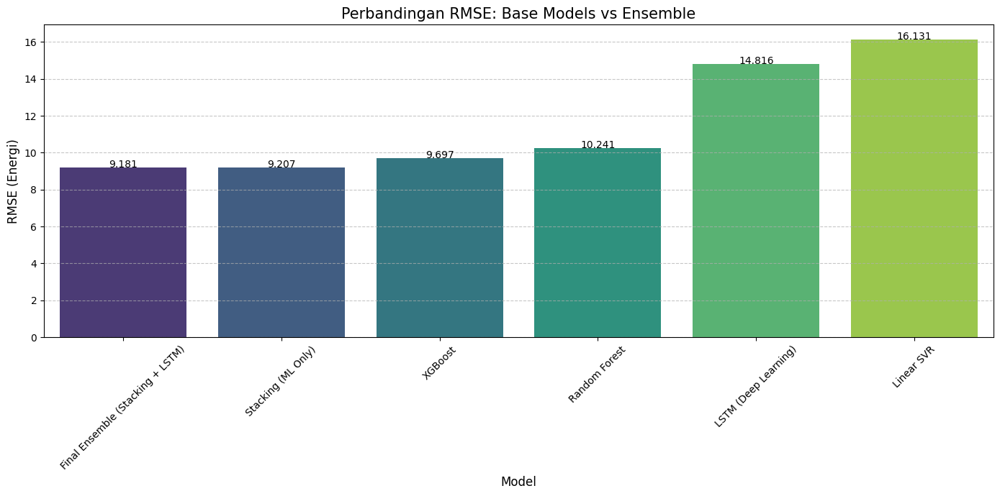

In [113]:
plt.figure(figsize=(14, 7))

# Plot RMSE
sns.barplot(data=df_eval, x='Model', y='RMSE', palette='viridis')

plt.title('Perbandingan RMSE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('RMSE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['RMSE'] + 0.01, f"{row['RMSE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

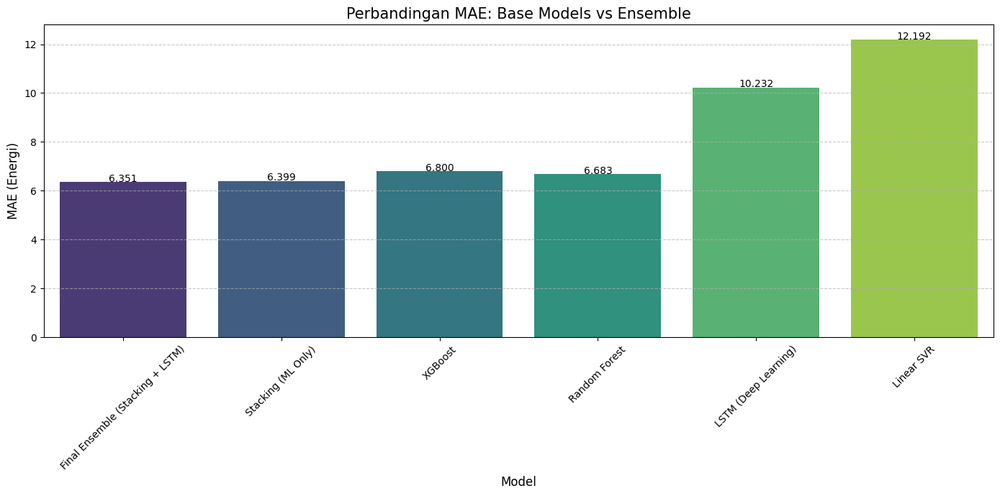

In [114]:
plt.figure(figsize=(14, 7))

# Plot MAE
sns.barplot(data=df_eval, x='Model', y='MAE', palette='viridis')

plt.title('Perbandingan MAE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('MAE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['MAE'] + 0.01, f"{row['MAE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

# Evaluate Tuned Model

In [124]:
import joblib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Path ke folder model
TUNE_MODEL_PATH = '/content/drive/MyDrive/ITS/Model_FP_Datmin/Tune/'
print("Library berhasil diimport.")

Library berhasil diimport.


In [125]:
print("Memuat model dari Google Drive...")

# 1. Load Model Machine Learning (Pickle)
try:
    svr_model = joblib.load(TUNE_MODEL_PATH + 'tuned_linear_svr_model.pkl')
    rf_model = joblib.load(TUNE_MODEL_PATH + 'tuned_random_forest_model.pkl')
    xgb_model = joblib.load(TUNE_MODEL_PATH + 'tuned_xgboost_model.pkl')
    stacking_model = joblib.load(TUNE_MODEL_PATH + 'tuned_ensemble_stacking_model.pkl')
    print("✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model ML: {e}")

# 2. Load Model Deep Learning (Keras/LSTM)
try:
    lstm_model = load_model(TUNE_MODEL_PATH + 'tuned_lstm_model.keras')
    print("✅ Model LSTM berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model LSTM: {e}")

Memuat model dari Google Drive...
✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.
✅ Model LSTM berhasil dimuat.


In [126]:
# Konfigurasi Time Steps (Sesuaikan dengan saat training, biasanya 24 jam)
TIME_STEPS = 12

def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    # Mengubah dataframe ke numpy array jika berupa DataFrame/Series
    X_val = X.values if isinstance(X, pd.DataFrame) else X
    y_val = y.values if isinstance(y, pd.Series) else y

    for i in range(len(X_val) - time_steps):
        Xs.append(X_val[i:(i + time_steps)])
        ys.append(y_val[i + time_steps])
    return np.array(Xs), np.array(ys)

print(f"Fungsi sequence siap. Menggunakan TIME_STEPS = {TIME_STEPS}")

Fungsi sequence siap. Menggunakan TIME_STEPS = 12


In [127]:
print("Melakukan prediksi...")

# Prediksi Model Machine Learning (SVR, RF, XGB, Stacking)
y_pred_svr_tuned = svr_model.predict(X_test)
y_pred_rf_tuned = rf_model.predict(X_test)
y_pred_xgb_tuned = xgb_model.predict(X_test)
y_pred_stack_tuned = stacking_model.predict(X_test)

# Prediksi LSTM
X_test_lstm, _ = create_sequences(X_test, y_test, TIME_STEPS)

# Prediksi
y_pred_lstm_raw = lstm_model.predict(X_test_lstm)
y_pred_lstm_tuned = y_pred_lstm_raw.flatten()

print("Prediksi selesai.")
print(f"Shape awal y_pred_stack: {y_pred_stack_tuned.shape}")
print(f"Shape awal y_pred_lstm: {y_pred_lstm_tuned.shape}")

Melakukan prediksi...
810/810 ━━━━━━━━━━━━━━━━━━━━ 5s 6ms/step
Prediksi selesai.
Shape awal y_pred_stack: (25932,)
Shape awal y_pred_lstm: (25920,)


In [128]:
# Potong Target Asli (y_test)
y_test_aligned_tuned = y_test.iloc[TIME_STEPS:]

# Potong Hasil Prediksi ML
y_pred_svr_tuned = y_pred_svr_tuned[TIME_STEPS:]
y_pred_rf_tuned = y_pred_rf_tuned[TIME_STEPS:]
y_pred_xgb_tuned = y_pred_xgb_tuned[TIME_STEPS:]
y_pred_stack_tuned = y_pred_stack_tuned[TIME_STEPS:]

# LSTM sudah otomatis terpotong karena proses create_sequences
print(f"Panjang data setalah alignment: {len(y_test_aligned_tuned)}")

if len(y_test_aligned_tuned) == len(y_pred_stack_tuned) == len(y_pred_lstm_tuned):
    print("✅ Alignment Sukses. Semua array memiliki panjang yang sama.")
else:
    print("❌ Warning: Panjang data tidak sama, cek kembali TIME_STEPS.")

Panjang data setalah alignment: 25920
✅ Alignment Sukses. Semua array memiliki panjang yang sama.


In [129]:
print("Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...")

# Pencarian Bobot Terbaik (Grid Search)
print("Mencari bobot optimal antara Stacking dan LSTM...")

best_rmse = float('inf')
best_weight_stack = 0.5

# Loop dari 0.0 sampai 1.0 (step 0.01)
for i in range(101):
    w_stack = i / 100.0
    w_lstm = 1.0 - w_stack

    # Hitung prediksi gabungan sementara
    current_pred = (y_pred_stack_tuned * w_stack) + (y_pred_lstm_tuned * w_lstm)

    # Hitung Error
    current_rmse = np.sqrt(mean_squared_error(y_test_aligned_tuned, current_pred))

    # Simpan jika ini error terendah
    if current_rmse < best_rmse:
        best_rmse = current_rmse
        best_weight_stack = w_stack

# Terapkan Bobot Terbaik
best_weight_lstm = 1.0 - best_weight_stack
print(f"Bobot Terbaik Ditemukan -> Stacking: {best_weight_stack:.2f} | LSTM: {best_weight_lstm:.2f}")

# Buat Prediksi Final
y_pred_final_tuned = (y_pred_stack_tuned * best_weight_stack) + (y_pred_lstm_tuned * best_weight_lstm)
print(f"RMSE Final Ensemble: {best_rmse:.4f}")

Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...
Mencari bobot optimal antara Stacking dan LSTM...
Bobot Terbaik Ditemukan -> Stacking: 0.97 | LSTM: 0.03
RMSE Final Ensemble: 8.5242


In [130]:
# Fungsi helper
def get_metrics(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return [name, mae, rmse]

# Kumpulkan semua hasil
evaluation_results = []
evaluation_results.append(get_metrics('Linear SVR', y_test_aligned_tuned, y_pred_svr_tuned))
evaluation_results.append(get_metrics('Random Forest', y_test_aligned_tuned, y_pred_rf_tuned))
evaluation_results.append(get_metrics('XGBoost', y_test_aligned_tuned, y_pred_xgb_tuned))
evaluation_results.append(get_metrics('LSTM (Deep Learning)', y_test_aligned_tuned, y_pred_lstm_tuned))
evaluation_results.append(get_metrics('Stacking (ML Only)', y_test_aligned_tuned, y_pred_stack_tuned))
evaluation_results.append(get_metrics('Final Ensemble (Stacking + LSTM)', y_test_aligned_tuned, y_pred_final_tuned))

# Buat DataFrame
df_eval = pd.DataFrame(evaluation_results, columns=['Model', 'MAE', 'RMSE'])
df_eval = df_eval.sort_values(by='RMSE', ascending=True).reset_index(drop=True)

print("Tabel Evaluasi Base Model:")
display(df_eval)

Tabel Evaluasi Base Model:


,Model,MAE,RMSE
0,XGBoost,5.722140,8.518145
1,Final Ensemble (Stacking + LSTM),5.786873,8.524164
2,Stacking (ML Only),5.808246,8.533582
3,Random Forest,6.669298,10.239681
4,LSTM (Deep Learning),9.631141,14.160854
5,Linear SVR,12.079061,15.531325


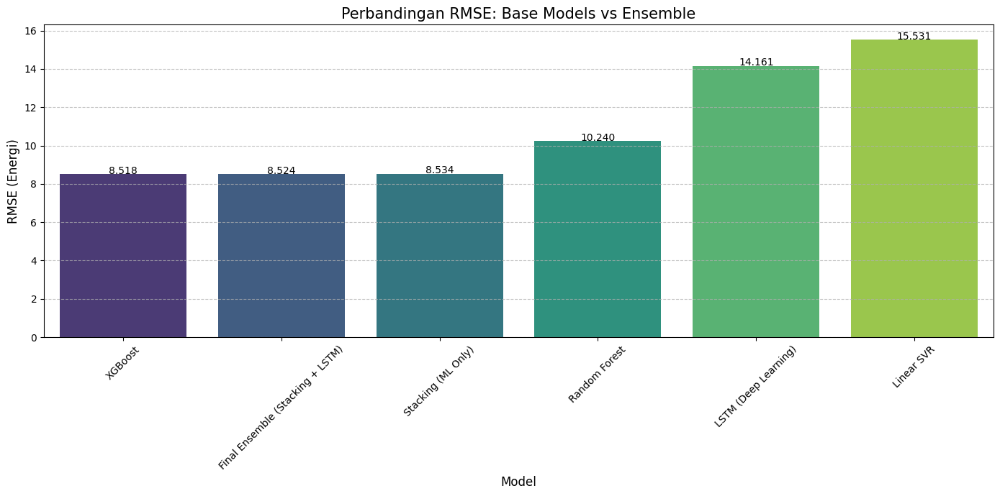

In [131]:
plt.figure(figsize=(14, 7))

# Plot RMSE
sns.barplot(data=df_eval, x='Model', y='RMSE', palette='viridis')

plt.title('Perbandingan RMSE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('RMSE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['RMSE'] + 0.01, f"{row['RMSE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

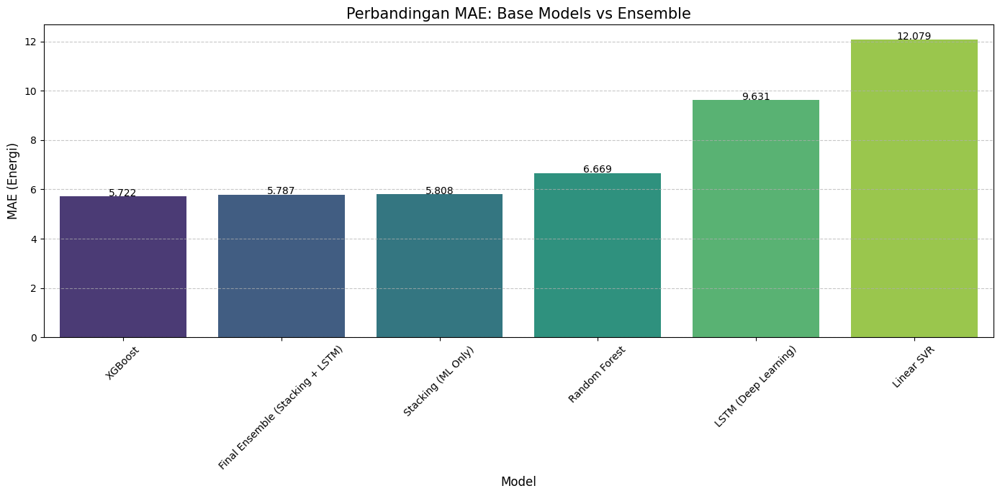

In [132]:
plt.figure(figsize=(14, 7))

# Plot MAE
sns.barplot(data=df_eval, x='Model', y='MAE', palette='viridis')

plt.title('Perbandingan MAE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('MAE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['MAE'] + 0.01, f"{row['MAE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

# Evaluate Feature Selection

In [158]:
# 1. Definisikan daftar fitur terpilih
selected_features = [
    'temperature_2m_archive_best_match (°C)',
    'hour',
    'soil_temperature_0_to_7cm_archive_best_match (°C)',
    'vapour_pressure_deficit_archive_best_match (kPa)',
    'relative_humidity_2m_archive_best_match (%)',
    'apparent_temperature_archive_best_match (°C)',
    'month',
    'total_column_integrated_water_vapour_archive_best_match (kg/m²)',
    'soil_temperature_7_to_28cm_archive_best_match (°C)',
    'wind_speed_10m_archive_best_match (km/h)',
    'cloud_cover_archive_best_match (%)',
    'cloud_cover_mid_archive_best_match (%)',
    'soil_moisture_28_to_100cm_archive_best_match (m³/m³)',
    'wind_gusts_10m_archive_best_match (km/h)',
    'cloud_cover_low_archive_best_match (%)',
    'soil_moisture_7_to_28cm_archive_best_match (m³/m³)',
    'soil_temperature_28_to_100cm_archive_best_match (°C)',
    'wet_bulb_temperature_2m_archive_best_match (°C)',
    'year',
    'cloud_cover_high_archive_best_match (%)'
]

# 2. Buat dataset baru hanya dengan kolom-kolom tersebut
# Menggunakan .copy() agar aman dari SettingWithCopyWarning
X_train_selected = X_train[selected_features].copy()
X_test_selected = X_test[selected_features].copy()

# 3. Verifikasi hasil
print(f"Jumlah fitur yang dipilih: {len(selected_features)}")
print(f"Shape X_train lama: {X_train.shape}")
print(f"Shape X_train baru: {X_train_selected.shape}")
print(f"Shape X_test baru : {X_test_selected.shape}")

print("\n5 Baris pertama X_train_selected:")
display(X_train_selected.head())

Jumlah fitur yang dipilih: 20
Shape X_train lama: (87660, 31)
Shape X_train baru: (87660, 20)
Shape X_test baru : (25932, 20)

5 Baris pertama X_train_selected:


,temperature_2m_archive_best_match (°C),hour,soil_temperature_0_to_7cm_archive_best_match (°C),vapour_pressure_deficit_archive_best_match (kPa),relative_humidity_2m_archive_best_match (%),apparent_temperature_archive_best_match (°C),month,total_column_integrated_water_vapour_archive_best_match (kg/m²),soil_temperature_7_to_28cm_archive_best_match (°C),wind_speed_10m_archive_best_match (km/h),cloud_cover_archive_best_match (%),cloud_cover_mid_archive_best_match (%),soil_moisture_28_to_100cm_archive_best_match (m³/m³),wind_gusts_10m_archive_best_match (km/h),cloud_cover_low_archive_best_match (%),soil_moisture_7_to_28cm_archive_best_match (m³/m³),soil_temperature_28_to_100cm_archive_best_match (°C),wet_bulb_temperature_2m_archive_best_match (°C),year,cloud_cover_high_archive_best_match (%)
6,-1.723089,-1.593255,-1.278395,-1.409095,1.604075,-1.361902,-1.601451,0.566320,-1.038860,-0.224164,1.002766,-0.869614,1.334689,-0.861150,-0.409157,1.317699,-0.851954,-0.123260,-1.647314,1.083465
7,-1.441289,-1.303572,-1.145240,-1.265018,1.417124,-0.955033,-1.601451,0.741461,-1.096475,-0.839256,0.974226,-0.279970,1.345536,-0.649318,0.029788,1.298436,-0.851954,0.013173,-1.647314,1.058291
8,-1.038718,-1.013890,-0.945507,-1.036897,1.105538,-0.622141,-1.601451,0.759897,-1.038860,-0.675231,0.974226,-0.053183,1.345536,-0.602244,0.155201,1.288805,-0.851954,0.217823,-1.647314,1.033117
9,-0.595890,-0.724207,-0.634812,-0.736738,0.731635,-0.326236,-1.601451,0.759897,-0.981245,-0.306176,1.002766,-0.325327,1.345536,-0.684623,0.155201,1.269543,-0.851954,0.354257,-1.647314,1.083465
10,-0.193319,-0.434524,-0.368502,-0.436579,0.420050,0.080633,-1.601451,0.750679,-0.866016,-0.101145,0.974226,-0.053183,1.345536,-0.519865,1.534743,1.259912,-0.851954,0.490690,-1.647314,1.007943


## Evaluasi

In [159]:
import joblib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Path ke folder model
SELECTED_MODEL_PATH = '/content/drive/MyDrive/ITS/Model_FP_Datmin/Selected/'
print("Library berhasil diimport.")

Library berhasil diimport.


In [160]:
print("Memuat model dari Google Drive...")

# Load Model Machine Learning (Pickle)
try:
    svr_model = joblib.load(SELECTED_MODEL_PATH + 'selected_linear_svr_model.pkl')
    rf_model = joblib.load(SELECTED_MODEL_PATH + 'selected_random_forest_model.pkl')
    xgb_model = joblib.load(SELECTED_MODEL_PATH + 'selected_xgboost_model.pkl')
    stacking_model = joblib.load(SELECTED_MODEL_PATH + 'selected_ensemble_stacking_model.pkl')
    print("✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model ML: {e}")

# Load Model Deep Learning (Keras/LSTM)
try:
    lstm_model = load_model(SELECTED_MODEL_PATH + 'selected_lstm_model.keras')
    print("✅ Model LSTM berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model LSTM: {e}")

Memuat model dari Google Drive...
✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.
✅ Model LSTM berhasil dimuat.


In [161]:
# Konfigurasi Time Steps (Sesuaikan dengan saat training, biasanya 24 jam)
TIME_STEPS = 12

def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    # Mengubah dataframe ke numpy array jika berupa DataFrame/Series
    X_val = X.values if isinstance(X, pd.DataFrame) else X
    y_val = y.values if isinstance(y, pd.Series) else y

    for i in range(len(X_val) - time_steps):
        Xs.append(X_val[i:(i + time_steps)])
        ys.append(y_val[i + time_steps])
    return np.array(Xs), np.array(ys)

print(f"Fungsi sequence siap. Menggunakan TIME_STEPS = {TIME_STEPS}")

Fungsi sequence siap. Menggunakan TIME_STEPS = 12


In [162]:
print("Melakukan prediksi...")

# Prediksi Model Machine Learning (SVR, RF, XGB, Stacking)
y_pred_svr_selected = svr_model.predict(X_test_selected)
y_pred_rf_selected = rf_model.predict(X_test_selected)
y_pred_xgb_selected = xgb_model.predict(X_test_selected)
y_pred_stack_selected = stacking_model.predict(X_test_selected)

# Prediksi LSTM

X_test_lstm, _ = create_sequences(X_test_selected, y_test, TIME_STEPS)

# Prediksi
y_pred_lstm_raw = lstm_model.predict(X_test_lstm)
y_pred_lstm_selected = y_pred_lstm_raw.flatten() # Ubah jadi 1 dimensi

print("Prediksi selesai.")
print(f"Shape awal y_pred_stack: {y_pred_stack_selected.shape}")
print(f"Shape awal y_pred_lstm: {y_pred_lstm_selected.shape}")

Melakukan prediksi...
810/810 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
Prediksi selesai.
Shape awal y_pred_stack: (25932,)
Shape awal y_pred_lstm: (25920,)


In [163]:
# Potong Target Asli (y_test)
y_test_aligned_selected = y_test.iloc[TIME_STEPS:]

# Potong Hasil Prediksi ML
y_pred_svr_selected = y_pred_svr_selected[TIME_STEPS:]
y_pred_rf_selected = y_pred_rf_selected[TIME_STEPS:]
y_pred_xgb_selected = y_pred_xgb_selected[TIME_STEPS:]
y_pred_stack_selected = y_pred_stack_selected[TIME_STEPS:]

# LSTM sudah otomatis terpotong karena proses create_sequences
print(f"Panjang data setalah alignment: {len(y_test_aligned)}")

if len(y_test_aligned_selected) == len(y_pred_stack_selected) == len(y_pred_lstm_selected):
    print("✅ Alignment Sukses. Semua array memiliki panjang yang sama.")
else:
    print("❌ Warning: Panjang data tidak sama, cek kembali TIME_STEPS.")

Panjang data setalah alignment: 25920
✅ Alignment Sukses. Semua array memiliki panjang yang sama.


In [164]:
print("Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...")

# Pencarian Bobot Terbaik (Grid Search)
print("Mencari bobot optimal antara Stacking dan LSTM...")

best_rmse = float('inf')
best_weight_stack = 0.5

# Loop dari 0.0 sampai 1.0 (step 0.01)
for i in range(101):
    w_stack = i / 100.0
    w_lstm = 1.0 - w_stack

    # Hitung prediksi gabungan sementara
    current_pred = (y_pred_stack_selected * w_stack) + (y_pred_lstm_selected * w_lstm)

    # Hitung Error
    current_rmse = np.sqrt(mean_squared_error(y_test_aligned_selected, current_pred))

    # Simpan jika ini error terendah
    if current_rmse < best_rmse:
        best_rmse = current_rmse
        best_weight_stack = w_stack

# Terapkan Bobot Terbaik
best_weight_lstm = 1.0 - best_weight_stack
print(f"Bobot Terbaik Ditemukan -> Stacking: {best_weight_stack:.2f} | LSTM: {best_weight_lstm:.2f}")

# Buat Prediksi Final
y_pred_final_selected = (y_pred_stack_selected * best_weight_stack) + (y_pred_lstm_selected * best_weight_lstm)
print(f"RMSE Final Ensemble: {best_rmse:.4f}")

Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...
Mencari bobot optimal antara Stacking dan LSTM...
Bobot Terbaik Ditemukan -> Stacking: 0.91 | LSTM: 0.09
RMSE Final Ensemble: 9.2464


In [165]:
# Fungsi helper
def get_metrics(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return [name, mae, rmse]

# Kumpulkan semua hasil
evaluation_results = []
evaluation_results.append(get_metrics('Linear SVR', y_test_aligned_selected, y_pred_svr_selected))
evaluation_results.append(get_metrics('Random Forest', y_test_aligned_selected, y_pred_rf_selected))
evaluation_results.append(get_metrics('XGBoost', y_test_aligned_selected, y_pred_xgb_selected))
evaluation_results.append(get_metrics('LSTM (Deep Learning)', y_test_aligned_selected, y_pred_lstm_selected))
evaluation_results.append(get_metrics('Stacking (ML Only)', y_test_aligned_selected, y_pred_stack_selected))
evaluation_results.append(get_metrics('Final Ensemble (Stacking + LSTM)', y_test_aligned_selected, y_pred_final_selected))

# Buat DataFrame
df_eval = pd.DataFrame(evaluation_results, columns=['Model', 'MAE', 'RMSE'])
df_eval = df_eval.sort_values(by='RMSE', ascending=True).reset_index(drop=True)

print("Tabel Evaluasi Base Model:")
display(df_eval)

Tabel Evaluasi Base Model:


,Model,MAE,RMSE
0,Final Ensemble (Stacking + LSTM),6.309576,9.246400
1,Stacking (ML Only),6.378318,9.294475
2,XGBoost,6.750573,9.677101
3,Random Forest,6.700253,10.164280
4,LSTM (Deep Learning),8.833857,13.309165
5,Linear SVR,13.777449,18.606915


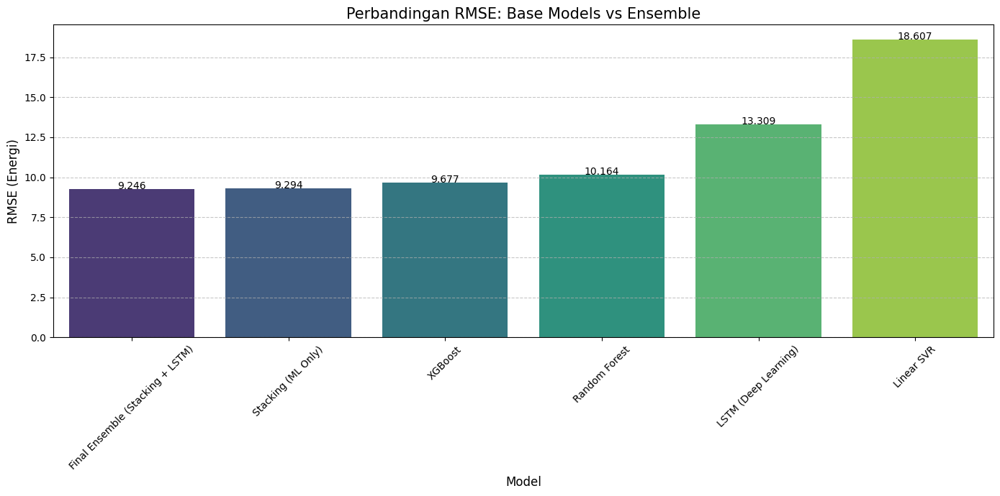

In [166]:
plt.figure(figsize=(14, 7))

# Plot RMSE
sns.barplot(data=df_eval, x='Model', y='RMSE', palette='viridis')

plt.title('Perbandingan RMSE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('RMSE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['RMSE'] + 0.01, f"{row['RMSE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

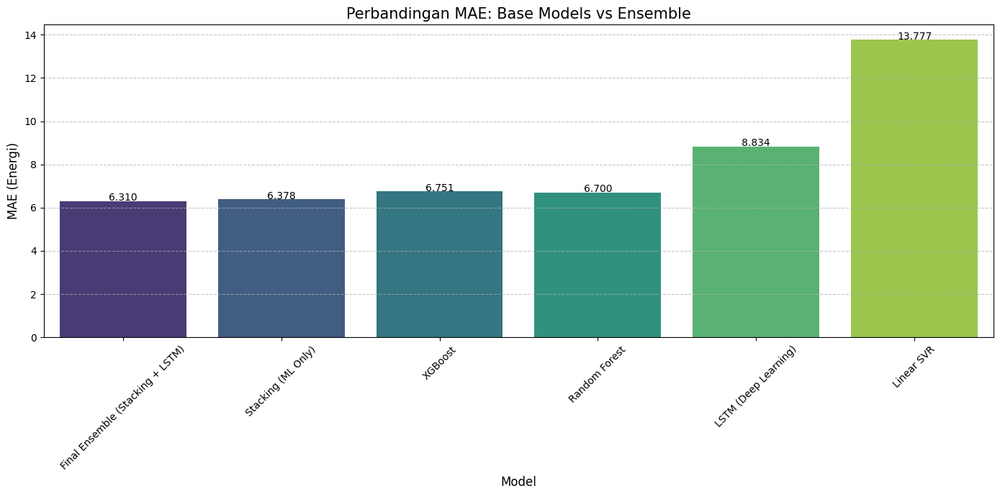

In [167]:
plt.figure(figsize=(14, 7))

# Plot MAE
sns.barplot(data=df_eval, x='Model', y='MAE', palette='viridis')

plt.title('Perbandingan MAE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('MAE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['MAE'] + 0.01, f"{row['MAE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

# Evaluate PCA

In [133]:
from sklearn.decomposition import PCA

# Inisialisasi PCA tanpa batas komponen
pca_full = PCA()
pca_full.fit(X_train)

# Menghitung varians kumulatif
cumulative_variance = np.cumsum(pca_full.explained_variance_ratio_)

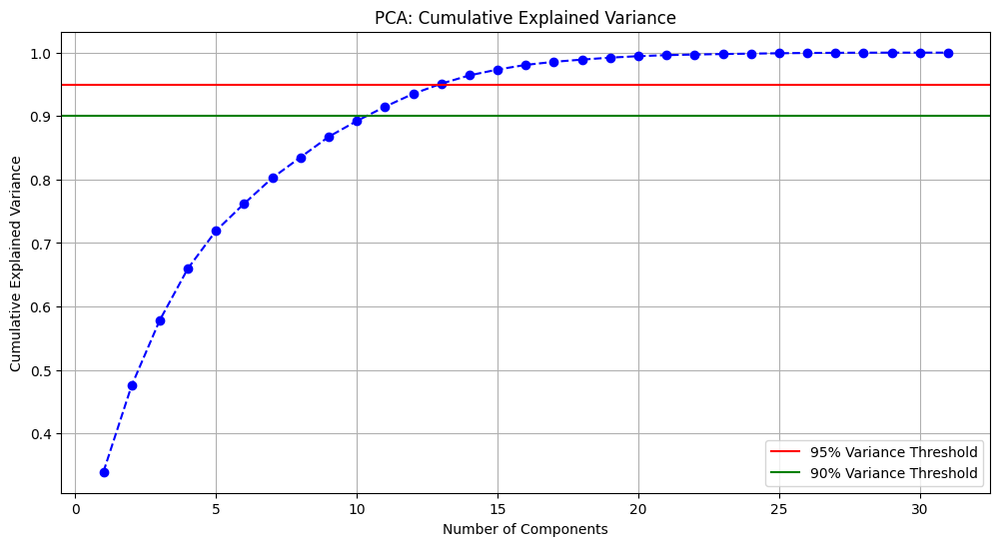

Jumlah komponen yang dibutuhkan untuk mempertahankan 95% informasi (varians): 13


In [134]:
plt.figure(figsize=(12, 6))

# Plot Varians Kumulatif
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='--', color='b')
plt.axhline(y=0.95, color='r', linestyle='-', label='95% Variance Threshold')
plt.axhline(y=0.90, color='g', linestyle='-', label='90% Variance Threshold')

plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA: Cumulative Explained Variance')
plt.legend(loc='best')
plt.grid()
plt.show()

# Cetak berapa komponen yang dibutuhkan untuk mencapai 95% varians
n_components_95 = np.argmax(cumulative_variance >= 0.95) + 1
print(f"Jumlah komponen yang dibutuhkan untuk mempertahankan 95% informasi (varians): {n_components_95}")

In [135]:
# 0.95 (95%) sebagai threshold agar tidak kehilangan terlalu banyak informasi
pca = PCA(n_components=0.95)

# Fit pada training set dan transform pada keduanya
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

# Mengubah hasil kembali ke DataFrame (Opsional, agar lebih mudah dibaca)
pca_cols = [f'PC{i+1}' for i in range(X_train_pca.shape[1])]
X_train_pca_df = pd.DataFrame(X_train_pca, columns=pca_cols, index=X_train.index)
X_test_pca_df = pd.DataFrame(X_test_pca, columns=pca_cols, index=X_test.index)

print("\nShape dataset setelah PCA:")
print(f"X_train_pca shape: {X_train_pca_df.shape}")
print(f"X_test_pca shape: {X_test_pca_df.shape}")

print("\n5 Baris pertama data hasil PCA:")
display(X_train_pca_df.head())


Shape dataset setelah PCA:
X_train_pca shape: (87660, 13)
X_test_pca shape: (25932, 13)

5 Baris pertama data hasil PCA:


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13
6,4.284005,-1.893776,0.357983,-0.674158,-0.699773,1.378144,0.465611,-0.539778,-1.748914,-0.209478,-1.952847,-0.722562,-0.225744
7,4.344968,-1.677788,-0.229177,-0.149048,-0.582207,1.493518,0.719575,-0.462493,-1.740424,0.133011,-1.179670,-0.510999,-0.241292
8,4.069906,-1.109039,-0.219409,0.097608,-0.670030,1.527912,0.821794,-0.411960,-1.729285,0.388921,-0.941316,-0.366663,-0.247241
9,3.627205,-0.491525,-0.028790,0.310941,-0.837956,1.632618,0.975081,-0.229844,-1.683102,0.545968,-1.075345,-0.494273,-0.138632
10,3.446829,0.472257,-0.066430,0.575540,-0.719736,1.655579,1.020491,-0.564875,-1.713512,1.123688,-0.189863,-1.116303,0.155120


## Evaluasi

In [148]:
import joblib
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import load_model
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Path ke folder model
PCA_MODEL_PATH = '/content/drive/MyDrive/ITS/Model_FP_Datmin/PCA/'
print("Library berhasil diimport.")

Library berhasil diimport.


In [149]:
print("Memuat model dari Google Drive...")

# 1. Load Model Machine Learning (Pickle)
try:
    svr_model = joblib.load(PCA_MODEL_PATH + 'pca_linear_svr_model.pkl')
    rf_model = joblib.load(PCA_MODEL_PATH + 'pca_random_forest_model.pkl')
    xgb_model = joblib.load(PCA_MODEL_PATH + 'pca_xgboost_model.pkl')
    stacking_model = joblib.load(PCA_MODEL_PATH + 'pca_ensemble_stacking_model.pkl')
    print("✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model ML: {e}")

# 2. Load Model Deep Learning (Keras/LSTM)
try:
    lstm_model = load_model(PCA_MODEL_PATH + 'pca_lstm_model.keras')
    print("✅ Model LSTM berhasil dimuat.")
except Exception as e:
    print(f"❌ Error memuat model LSTM: {e}")

Memuat model dari Google Drive...
✅ Model ML (SVR, RF, XGB, Stacking) berhasil dimuat.
✅ Model LSTM berhasil dimuat.


In [150]:
# Konfigurasi Time Steps (Sesuaikan dengan saat training, biasanya 24 jam)
TIME_STEPS = 12

def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    # Mengubah dataframe ke numpy array jika berupa DataFrame/Series
    X_val = X.values if isinstance(X, pd.DataFrame) else X
    y_val = y.values if isinstance(y, pd.Series) else y

    for i in range(len(X_val) - time_steps):
        Xs.append(X_val[i:(i + time_steps)])
        ys.append(y_val[i + time_steps])
    return np.array(Xs), np.array(ys)

print(f"Fungsi sequence siap. Menggunakan TIME_STEPS = {TIME_STEPS}")

Fungsi sequence siap. Menggunakan TIME_STEPS = 12


In [151]:
print("Melakukan prediksi...")

# Prediksi Model Machine Learning (SVR, RF, XGB, Stacking)
y_pred_svr_pca = svr_model.predict(X_test_pca)
y_pred_rf_pca = rf_model.predict(X_test_pca)
y_pred_xgb_pca = xgb_model.predict(X_test_pca)
y_pred_stack_pca = stacking_model.predict(X_test_pca)

# Prediksi LSTM
X_test_lstm, _ = create_sequences(X_test_pca, y_test, TIME_STEPS)

# Prediksi
y_pred_lstm_raw = lstm_model.predict(X_test_lstm)
y_pred_lstm_pca = y_pred_lstm_raw.flatten() # Ubah jadi 1 dimensi

print("Prediksi selesai.")
print(f"Shape awal y_pred_stack: {y_pred_stack_pca.shape}")
print(f"Shape awal y_pred_lstm: {y_pred_lstm_pca.shape}")

Melakukan prediksi...
810/810 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step
Prediksi selesai.
Shape awal y_pred_stack: (25932,)
Shape awal y_pred_lstm: (25920,)


In [153]:
# Potong Target Asli (y_test)
y_test_aligned_pca = y_test.iloc[TIME_STEPS:]

# Potong Hasil Prediksi ML
y_pred_svr_pca = y_pred_svr_pca[TIME_STEPS:]
y_pred_rf_pca = y_pred_rf_pca[TIME_STEPS:]
y_pred_xgb_pca = y_pred_xgb_pca[TIME_STEPS:]
y_pred_stack_pca = y_pred_stack_pca[TIME_STEPS:]

# LSTM sudah otomatis terpotong karena proses create_sequences
print(f"Panjang data setalah alignment: {len(y_test_aligned_pca)}")

if len(y_test_aligned_pca) == len(y_pred_stack_pca) == len(y_pred_lstm_pca):
    print("✅ Alignment Sukses. Semua array memiliki panjang yang sama.")
else:
    print("❌ Warning: Panjang data tidak sama, cek kembali TIME_STEPS.")

Panjang data setalah alignment: 25920
✅ Alignment Sukses. Semua array memiliki panjang yang sama.


In [154]:
print("Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...")

# Pencarian Bobot Terbaik (Grid Search)
print("Mencari bobot optimal antara Stacking dan LSTM...")

best_rmse = float('inf')
best_weight_stack = 0.5

# Loop dari 0.0 sampai 1.0 (step 0.01)
for i in range(101):
    w_stack = i / 100.0
    w_lstm = 1.0 - w_stack

    # Hitung prediksi gabungan sementara
    current_pred = (y_pred_stack_pca * w_stack) + (y_pred_lstm_pca * w_lstm)

    # Hitung Error
    current_rmse = np.sqrt(mean_squared_error(y_test_aligned_pca, current_pred))

    # Simpan jika ini error terendah
    if current_rmse < best_rmse:
        best_rmse = current_rmse
        best_weight_stack = w_stack

# Terapkan Bobot Terbaik
best_weight_lstm = 1.0 - best_weight_stack
print(f"Bobot Terbaik Ditemukan -> Stacking: {best_weight_stack:.2f} | LSTM: {best_weight_lstm:.2f}")

# Buat Prediksi Final
y_pred_final_pca = (y_pred_stack_pca * best_weight_stack) + (y_pred_lstm_pca * best_weight_lstm)
print(f"RMSE Final Ensemble: {best_rmse:.4f}")

Membuat Final Ensemble (Gabungan Stacking ML & LSTM)...
Mencari bobot optimal antara Stacking dan LSTM...
Bobot Terbaik Ditemukan -> Stacking: 0.22 | LSTM: 0.78
RMSE Final Ensemble: 13.9997


In [155]:
# Fungsi helper
def get_metrics(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return [name, mae, rmse]

# Kumpulkan semua hasil
evaluation_results = []
evaluation_results.append(get_metrics('Linear SVR', y_test_aligned_pca, y_pred_svr_pca))
evaluation_results.append(get_metrics('Random Forest', y_test_aligned_pca, y_pred_rf_pca))
evaluation_results.append(get_metrics('XGBoost', y_test_aligned_pca, y_pred_xgb_pca))
evaluation_results.append(get_metrics('LSTM (Deep Learning)', y_test_aligned_pca, y_pred_lstm_pca))
evaluation_results.append(get_metrics('Stacking (ML Only)', y_test_aligned_pca, y_pred_stack_pca))
evaluation_results.append(get_metrics('Final Ensemble (Stacking + LSTM)', y_test_aligned_pca, y_pred_final_pca))

# Buat DataFrame
df_eval = pd.DataFrame(evaluation_results, columns=['Model', 'MAE', 'RMSE'])
df_eval = df_eval.sort_values(by='RMSE', ascending=True).reset_index(drop=True)

print("Tabel Evaluasi Base Model:")
display(df_eval)

Tabel Evaluasi Base Model:


,Model,MAE,RMSE
0,Final Ensemble (Stacking + LSTM),10.235676,13.999662
1,LSTM (Deep Learning),10.405974,14.703877
2,Stacking (ML Only),16.026436,21.087520
3,XGBoost,16.992776,22.248380
4,Random Forest,18.215946,23.474458
5,Linear SVR,21.060493,26.391156


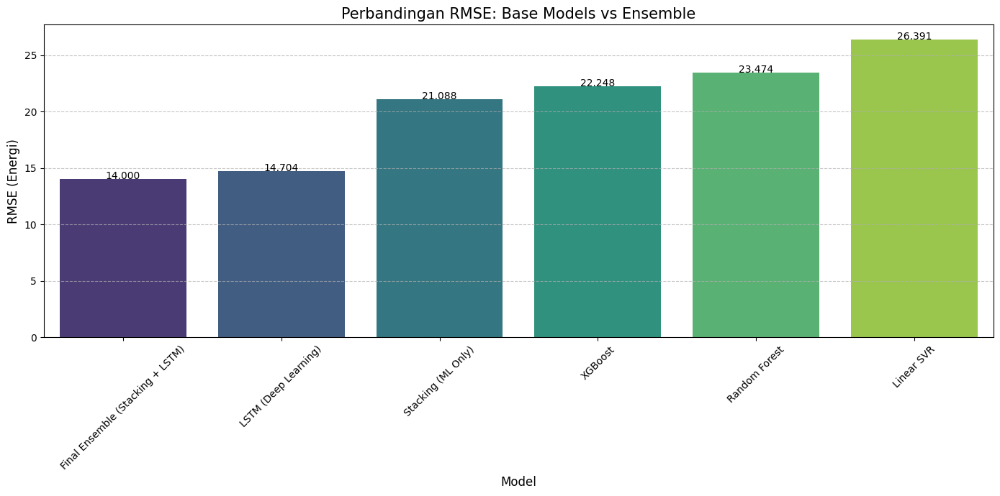

In [156]:
plt.figure(figsize=(14, 7))

# Plot RMSE
sns.barplot(data=df_eval, x='Model', y='RMSE', palette='viridis')

plt.title('Perbandingan RMSE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('RMSE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['RMSE'] + 0.01, f"{row['RMSE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

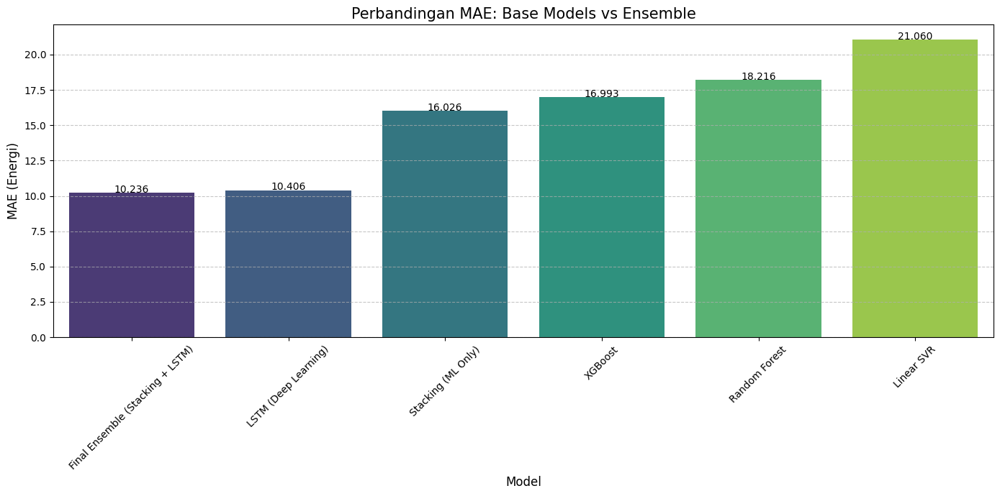

In [157]:
plt.figure(figsize=(14, 7))

# Plot MAE
sns.barplot(data=df_eval, x='Model', y='MAE', palette='viridis')

plt.title('Perbandingan MAE: Base Models vs Ensemble', fontsize=15)
plt.ylabel('MAE (Energi)', fontsize=12)
plt.xlabel('Model', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Menambahkan label nilai di atas batang
for index, row in df_eval.iterrows():
    plt.text(index, row['MAE'] + 0.01, f"{row['MAE']:.3f}", color='black', ha="center")

plt.tight_layout()
plt.show()

# Perbandingan Ensemble


Perbandingan Hasil Final Ensemble (Stacking + LSTM):


,Model,MAE,RMSE
0,Final Ensemble (Tuned),5.786873,8.524164
1,Final Ensemble (Base),6.351456,9.180517
2,Final Ensemble (Selected),6.309576,9.246400
3,Final Ensemble (PCA),10.235676,13.999662


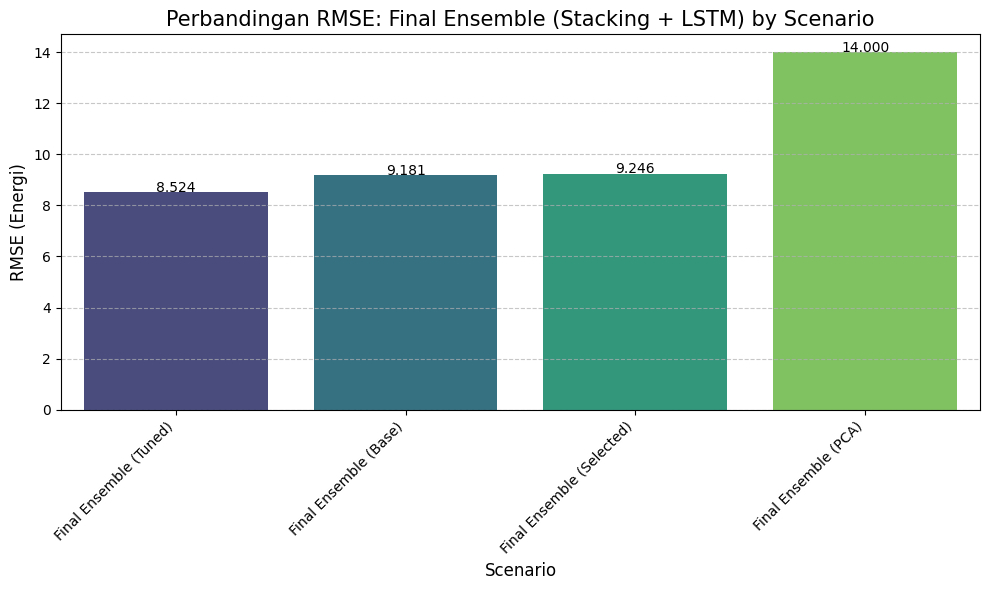

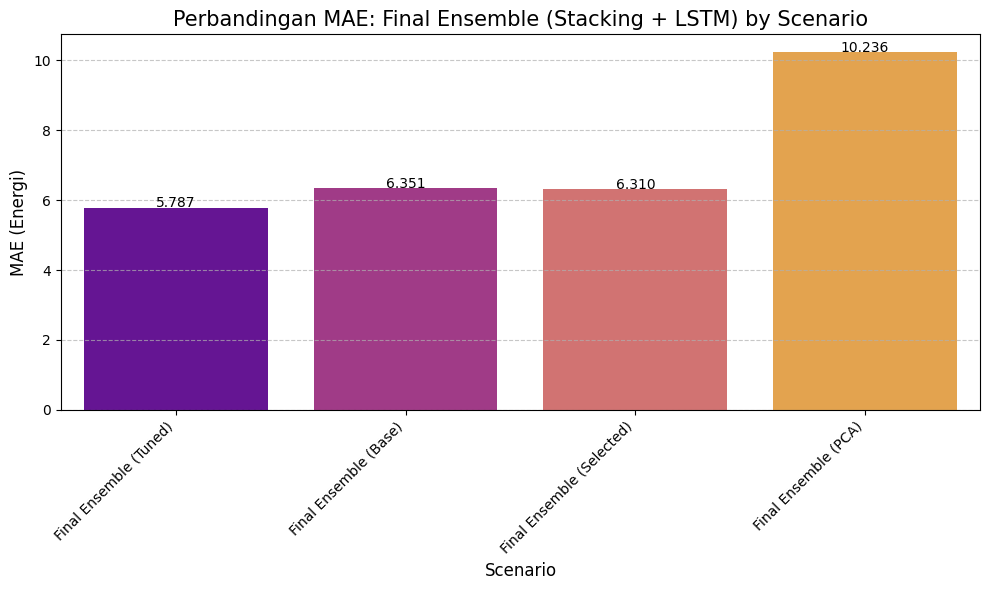

In [169]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Helper function to get metrics (already defined previously, but good to have in scope)
def get_metrics(name, y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return [name, mae, rmse]

# Collect results for Final Ensemble from each scenario
comparison_results = []

# Base Model Ensemble
comparison_results.append(get_metrics('Final Ensemble (Base)', y_test_aligned_base, y_pred_final_base))

# Tuned Model Ensemble
comparison_results.append(get_metrics('Final Ensemble (Tuned)', y_test_aligned_tuned, y_pred_final_tuned))

# PCA Model Ensemble
comparison_results.append(get_metrics('Final Ensemble (PCA)', y_test_aligned_pca, y_pred_final_pca))

# Selected Model Ensemble
comparison_results.append(get_metrics('Final Ensemble (Selected)', y_test_aligned_selected, y_pred_final_selected))

# Create DataFrame for comparison
df_comparison = pd.DataFrame(comparison_results, columns=['Model', 'MAE', 'RMSE'])
df_comparison = df_comparison.sort_values(by='RMSE', ascending=True).reset_index(drop=True)

print("\nPerbandingan Hasil Final Ensemble (Stacking + LSTM):")
display(df_comparison)

# Plotting RMSE Comparison
plt.figure(figsize=(10, 6))
sns.barplot(data=df_comparison, x='Model', y='RMSE', palette='viridis')
plt.title('Perbandingan RMSE: Final Ensemble (Stacking + LSTM) by Scenario', fontsize=15)
plt.ylabel('RMSE (Energi)', fontsize=12)
plt.xlabel('Scenario', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
for index, row in df_comparison.iterrows():
    plt.text(index, row['RMSE'] + 0.01, f"{row['RMSE']:.3f}", color='black', ha="center")
plt.tight_layout()
plt.show()

# Plotting MAE Comparison
plt.figure(figsize=(10, 6))
sns.barplot(data=df_comparison, x='Model', y='MAE', palette='plasma')
plt.title('Perbandingan MAE: Final Ensemble (Stacking + LSTM) by Scenario', fontsize=15)
plt.ylabel('MAE (Energi)', fontsize=12)
plt.xlabel('Scenario', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
for index, row in df_comparison.iterrows():
    plt.text(index, row['MAE'] + 0.01, f"{row['MAE']:.3f}", color='black', ha="center")
plt.tight_layout()
plt.show()

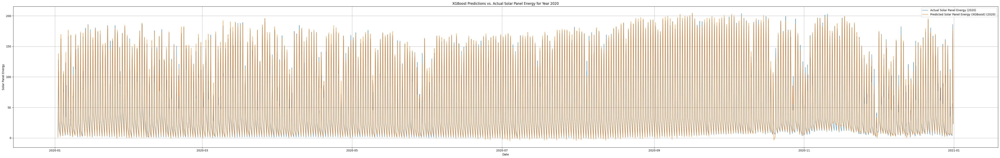

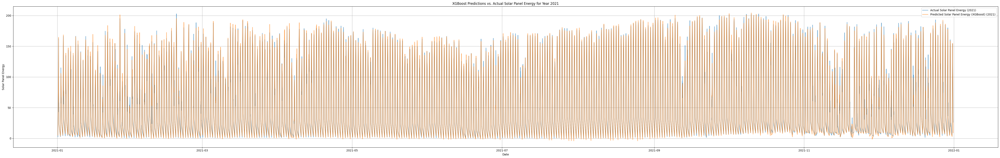

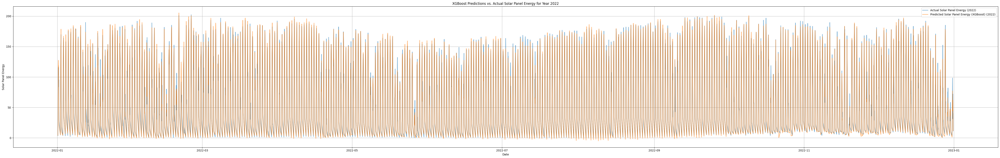

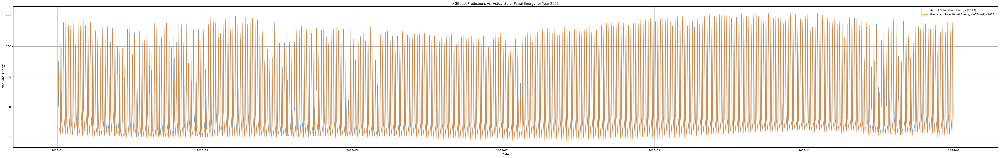

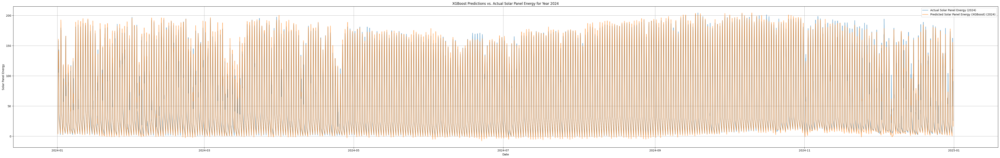

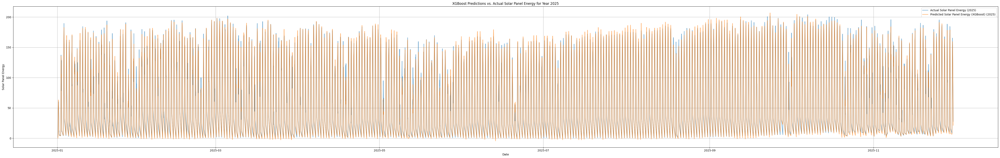

In [171]:
import matplotlib.pyplot as plt
import pandas as pd

# Create a DataFrame for plotting
plot_df = pd.DataFrame({
    'time': test_df['time'].iloc[TIME_STEPS:], # Slice 'time' to match the aligned data
    'Actual': y_test_aligned_tuned,
    'Predicted': y_pred_final_tuned
})

# Extract unique years from the test set
years = plot_df['time'].dt.year.unique()

for year in sorted(years):
    yearly_df = plot_df[plot_df['time'].dt.year == year]

    plt.figure(figsize=(50, 8)) # Make the image wider
    plt.plot(yearly_df['time'], yearly_df['Actual'], label=f'Actual Solar Panel Energy ({year})', alpha=0.7)
    plt.plot(yearly_df['time'], yearly_df['Predicted'], label=f'Predicted Solar Panel Energy (XGBoost) ({year})', alpha=0.7)
    plt.title(f'XGBoost Predictions vs. Actual Solar Panel Energy for Year {year}')
    plt.xlabel('Date')
    plt.ylabel('Solar Panel Energy')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

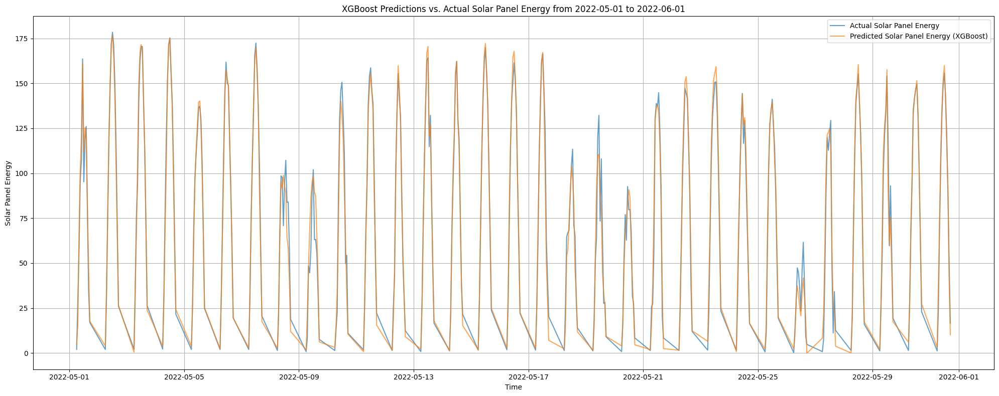

Visualization of XGBoost predictions for the period 2022-05-01 to 2022-06-01 complete.


In [172]:
import matplotlib.pyplot as plt
import pandas as pd

# Create a DataFrame for plotting if not already existing from previous steps
if 'plot_df' not in locals():
    plot_df = pd.DataFrame({
      'time': test_df['time'].iloc[TIME_STEPS:], # Slice 'time' to match the aligned data
      'Actual': y_test_aligned_tuned,
      'Predicted': y_pred_final_tuned
    })

# Prompt user for start and end dates
# start_date_str = input("Enter the start date (YYYY-MM-DD): ")
# end_date_str = input("Enter the end date (YYYY-MM-DD): ")
start_date_str = "2022-05-01"
end_date_str = "2022-06-01"

try:
    start_date = pd.to_datetime(start_date_str)
    end_date = pd.to_datetime(end_date_str)

    # Filter the DataFrame based on user-provided dates
    filtered_df = plot_df[(plot_df['time'] >= start_date) & (plot_df['time'] <= end_date)].copy()

    if not filtered_df.empty:
        plt.figure(figsize=(20, 8))
        plt.plot(filtered_df['time'], filtered_df['Actual'], label='Actual Solar Panel Energy', alpha=0.7)
        plt.plot(filtered_df['time'], filtered_df['Predicted'], label='Predicted Solar Panel Energy (XGBoost)', alpha=0.7)
        plt.title(f'XGBoost Predictions vs. Actual Solar Panel Energy from {start_date.strftime('%Y-%m-%d')} to {end_date.strftime('%Y-%m-%d')}')
        plt.xlabel('Time')
        plt.ylabel('Solar Panel Energy')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        print(f"Visualization of XGBoost predictions for the period {start_date.strftime('%Y-%m-%d')} to {end_date.strftime('%Y-%m-%d')} complete.")
    else:
        print("No data available for the specified date range. Please try different dates.")

except ValueError:
    print("Invalid date format. Please use YYYY-MM-DD.")
except Exception as e:
    print(f"An error occurred: {e}")